In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.offline as py_offline

import os
import sys

# sys.path.append('/home/kruu/git_folder/wake_encounter/P2P_base')
# parent_dir = os.path.abspath("/home/kruu/git_folder/")
# if parent_dir not in sys.path:
#     sys.path.append(parent_dir)
# import utils.viz as viz

# Located on the cluster, accessible by everyone
source_path = "/store/kruu/wake_encounter_simulations/t20_phi0_speed80_discrete_theta_right_only_wake_A320"

# Parameters of encounter simulations

In [3]:
directories = sorted([d for d in os.listdir(os.path.join(source_path, "encounters")) if d.isdigit()])

dataframes = []

for dir_name in directories:
    file_path = os.path.join(source_path, "encounters", dir_name, "param.parquet")
    
    if os.path.exists(file_path):
        df = pd.read_parquet(file_path)
        df['simulation_index'] = int(dir_name)
        dataframes.append(df)

aggregated_params = pd.concat(dataframes, ignore_index=True)
aggregated_params

,wake_id,aircraft_type,crop_distance,speed,t_target,theta,phi,x_target,y_target,z_target,simulation_index
0,0,A320,1500.0,80,20,-80,0,2.462,-40.082,1969.74,0
1,0,A320,1500.0,80,20,-80,0,2.462,-40.082,1969.74,1
2,0,A320,1500.0,80,20,90,0,2.462,-40.082,1969.74,10
3,0,A320,1500.0,80,20,-20,0,2.462,-40.082,1969.74,11
4,0,A320,1500.0,80,20,45,0,2.462,-40.082,1969.74,12
...,...,...,...,...,...,...,...,...,...,...,...
95,0,A320,1500.0,80,20,20,0,2.462,-40.082,1969.74,95
96,0,A320,1500.0,80,20,45,0,2.462,-40.082,1969.74,96
97,0,A320,1500.0,80,20,-10,0,2.462,-40.082,1969.74,97
98,0,A320,1500.0,80,20,-60,0,2.462,-40.082,1969.74,98


# Parameters of the Wake simulation

In [4]:
sim = aggregated_params["wake_id"].unique()[0]

# Wake parameters
wake_params = pd.read_parquet(os.path.join(source_path, "wakes", str(sim), "param.parquet"))
wake_params

,run_id,alt_aircraft,spread,step,wind_vel,wind_dir,temp,p_ref,tke,speed,mass,wingspan,timestep,wind_vertical_vel,alt_sensor,qq,gpa
0,0,2000.0,1000,10,2.0,130.0,288.15,101300.0,10.0,100.0,136000.0,47.3,0.1,0.0,10.0,0.05,0.0


In [5]:
wake_df = pd.read_parquet(os.path.join(source_path, "wakes", str(sim), "wakes_df.parquet"))

In [9]:
viz.visualise_vortex(wake_df)

# Plots of RMC

In [6]:
directories = sorted([d for d in os.listdir(os.path.join(source_path, "encounters")) if d.isdigit()])

results = {}

for dir_name in directories:
    results_file_path = os.path.join(source_path, "encounters", dir_name, "results.parquet")
    encounter_file_path = os.path.join(source_path, "encounters", dir_name, "encounter_df.parquet")
    
    if os.path.exists(results_file_path):
        df = pd.read_parquet(results_file_path)
        enc = pd.read_parquet(encounter_file_path)
        df.index = df.index + enc.index[0] + 1 # +1 because the results are calculated for t=1 and not t=0
        results[int(dir_name)] = df

In [56]:
aggregated_params.query("theta > 0")

,wake_id,aircraft_type,crop_distance,speed,t_target,theta,phi,x_target,y_target,z_target,simulation_index
2,0,A320,1500.0,80,20,90,0,2.462,-40.082,1969.74,10
4,0,A320,1500.0,80,20,45,0,2.462,-40.082,1969.74,12
6,0,A320,1500.0,80,20,30,0,2.462,-40.082,1969.74,14
12,0,A320,1500.0,80,20,10,0,2.462,-40.082,1969.74,2
13,0,A320,1500.0,80,20,10,0,2.462,-40.082,1969.74,20
14,0,A320,1500.0,80,20,20,0,2.462,-40.082,1969.74,21
19,0,A320,1500.0,80,20,30,0,2.462,-40.082,1969.74,26
23,0,A320,1500.0,80,20,45,0,2.462,-40.082,1969.74,3
24,0,A320,1500.0,80,20,45,0,2.462,-40.082,1969.74,30
25,0,A320,1500.0,80,20,20,0,2.462,-40.082,1969.74,31


In [64]:
forces = ["C_L", "C_D", "C_Y"] #Lift, Drag, Side
moments = ["C_l", "C_m", "C_n"] #rolling, pitching, yawing

#Randomly selecting 5 simulations to plot
sim_to_plot = np.array([1, 11, 13, 16, 18])
# sim_to_plot = np.array([10, 12, 14, 2, 21])
# sim_to_plot = np.random.choice(list(aggregated_params.query("theta <= 0").simulation_index), size=5, replace=False)
# sim_to_plot = np.random.choice(list(results.keys()), size=5, replace=False)
# sim_to_plot = aggregated_params.simulation_index

#Labels are the simulation indexes
# labels = sim_to_plot
labels = aggregated_params.query(f"simulation_index in {sim_to_plot.tolist()}").theta.values

# List of dataframes
# You can select the simulations you want to plot by changing the sim_to_plot list ex: [1,2,3,4]
dataframes = [results[i] for i in sim_to_plot]

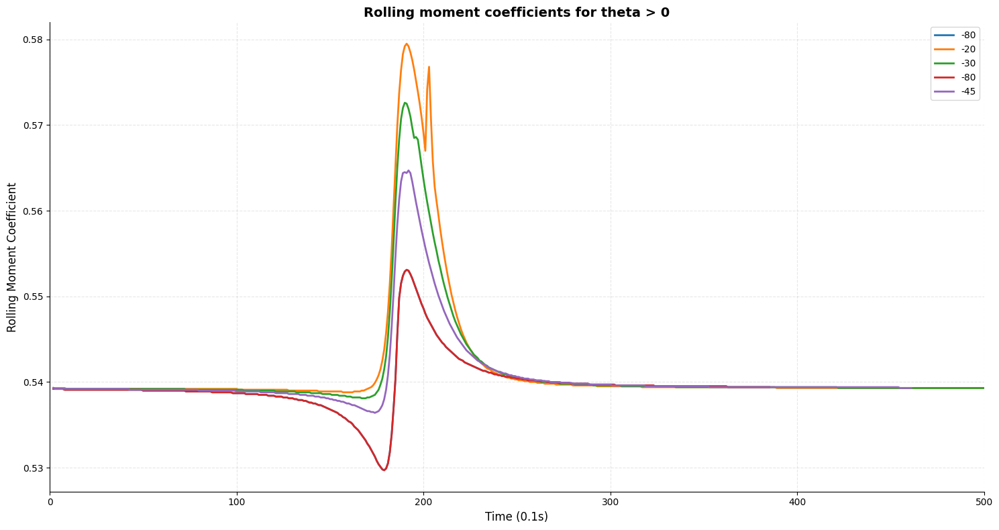

In [ ]:
plt.figure(figsize=(15, 8))
plt.grid(alpha=0.3, linestyle='--')

for i, (df, label) in enumerate(zip(dataframes, labels)):
    plt.plot(df["C_l"], label=label, linewidth=2)

plt.legend(title="Scenarios", fontsize='medium', frameon=False)
plt.legend()

# Add labels and title for better clarity
plt.xlabel("Time (0.1s)", fontsize=12)
plt.ylabel("Rolling Moment Coefficient", fontsize=12)
plt.title("Rolling moment coefficients for theta > 0", fontsize=14, fontweight='bold')

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(0, 500)
plt.tight_layout()

plt.gca().spines['top'].set_visible(False) 
plt.gca().spines['right'].set_visible(False) 

# Show the plot
plt.show()


# Plots of "high RMC"

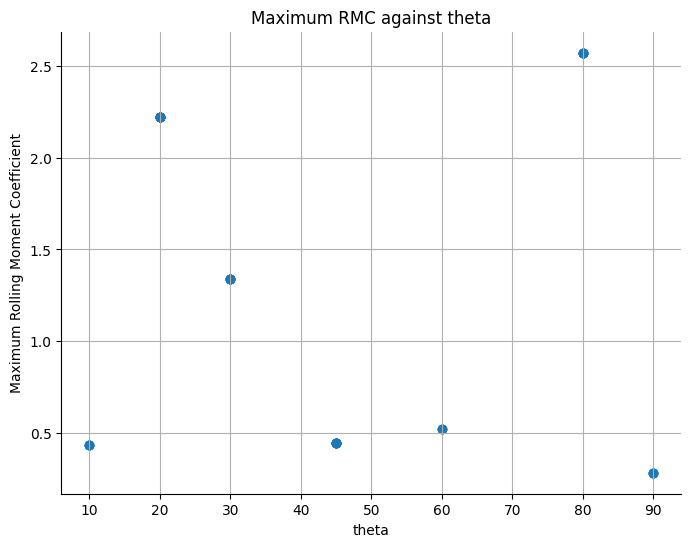

In [62]:
param_to_plot = "theta"
neg_theta = aggregated_params.query("theta > 0").simulation_index
neg_df = {i: results[i] for i in neg_theta}

max_c_l_values = {k: v["C_l"].abs().max() for k, v in neg_df.items()}
# max_c_l_values = {k: v["C_l"].abs().max() for k, v in results.items()}
params = {k: aggregated_params.query(f"simulation_index == {k}")[f"{param_to_plot}"].values[0] for k in max_c_l_values.keys()}

#plot max c_l vs speed
plt.figure(figsize=(8, 6))
plt.scatter(params.values(), max_c_l_values.values())
plt.xlabel(f"{param_to_plot}")
plt.ylabel("Maximum Rolling Moment Coefficient")
plt.title(f"Maximum RMC against {param_to_plot}")
plt.gca().spines['top'].set_visible(False) 
plt.gca().spines['right'].set_visible(False) 
plt.grid(True)
plt.show()

In [15]:
# Calulation of quantiles on the maximum RMC of each simulation
coef = "C_l"

# all_c_l_values = pd.concat([df['C_l'].abs() for df in results.values()])
max_c_l_values = pd.Series([df[coef].abs().max() for df in results.values()])
quantiles = max_c_l_values.quantile([0.25, 0.5, 0.75, 0.90, 0.95, 0.99])
print(quantiles)

keys_above_quantile = [
    key for key, df in results.items()
    if (df[coef].abs() >= max_c_l_values.quantile(0.90)).any()
]

# keys_above_quantile = [
#     key for key, df in results.items()
#     if (0.1 <= df[coef].abs().max() <= 0.3)
# ]

severe_encounter = aggregated_params.query(f"simulation_index in {keys_above_quantile}")

0.25     0.063368
0.50     0.319122
0.75     1.518019
0.90     4.856606
0.95     6.012593
0.99    27.976347
dtype: float64


In [16]:
severe_encounter

,wake_id,aircraft_type,crop_distance,speed,t_target,theta,phi,x_target,y_target,z_target,simulation_index
14,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,21
38,0,C130,1500.0,80,20,60,0,2.462,-40.082,1969.74,43
41,0,C130,1500.0,80,20,60,0,2.462,-40.082,1969.74,46
44,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,49
53,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,57
56,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,6
58,0,C130,1500.0,80,20,60,0,2.462,-40.082,1969.74,61
64,0,C130,1500.0,80,20,60,0,2.462,-40.082,1969.74,67
68,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,70
71,0,C130,1500.0,80,20,30,0,2.462,-40.082,1969.74,73


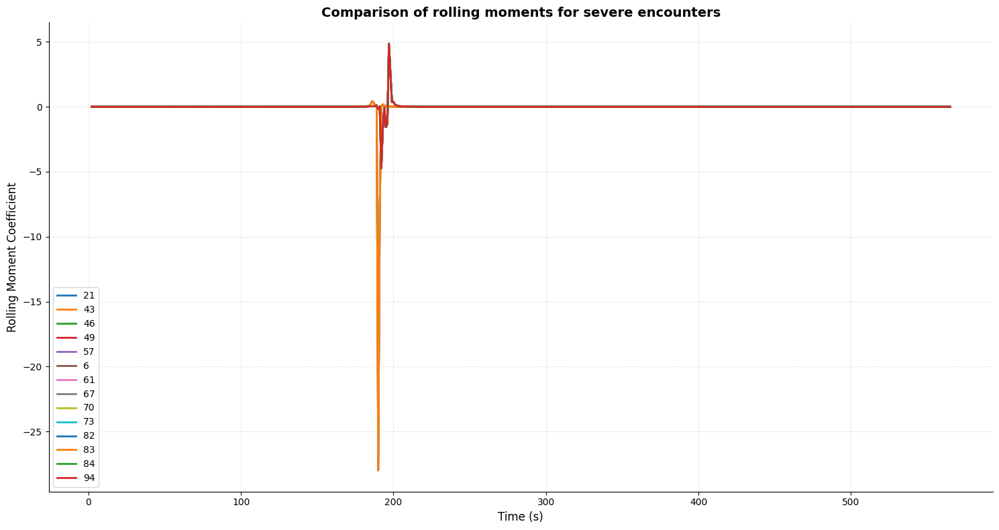

In [17]:
plt.figure(figsize=(15, 8))
plt.grid(alpha=0.3, linestyle='--')

for i in severe_encounter.simulation_index:
    plt.plot(results[i]["C_l"], label = i, linewidth=2)

plt.legend(title="Scenarios", fontsize='medium', frameon=False)
plt.legend()

# Add labels and title for better clarity
plt.xlabel("Time (s)", fontsize=12)
plt.ylabel("Rolling Moment Coefficient", fontsize=12)
plt.title("Comparison of rolling moments for severe encounters", fontsize=14, fontweight='bold')

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.tight_layout()

plt.gca().spines['top'].set_visible(False) 
plt.gca().spines['right'].set_visible(False) 

# Show the plot
plt.show()

# Plots of wake + encounter

In [18]:
# Select the simulation you want to plot
sim_id = 1
encounter_df = pd.read_parquet(os.path.join(source_path, "encounters", str(sim_id), "encounter_df.parquet"))
wake_df = pd.read_parquet(os.path.join(source_path, "wakes", str(0), "wakes_df.parquet"))

In [19]:
import sys
sys.path.append('/home/kruu/git_folder/P2P_base')
import utils.viz as viz

#Transform initial wakes dataframe into a dataframe that can be plotted
def calculate_wake_locations(wake_df: pd.DataFrame) -> pd.DataFrame:
    
    # Create dataframe containing info for both vortex cores
    data_l = wake_df[["yl", "zl", "gam_l"]].rename(
        columns={"yl": "y", "zl": "z", "gam_l": "gam"}
    )
    data_l["t"] = wake_df.index
    data_l["side"] = "left"

    data_r = wake_df[["yr", "zr", "gam_r"]].rename(
        columns={"yr": "y", "zr": "z", "gam_r": "gam"}
    )
    data_r["t"] = wake_df.index
    data_r["side"] = "right"

    data_wakes = pd.concat([data_l, data_r])
    data_wakes["size"] = 30

    # Add information about uncertainty
    for index, row in wake_df.iterrows():
        t = index
        gam = 1
        size = 1
        x_vals_ellipse_2s, y_vals_ellipse_2s = viz.get_ellipse_points(
            row["y_2s_l"],
            row["y_2s_r"],
            row["z_2s_lo"],
            row["z_2s_hi"],
            num_points=100,
        )
        x_vals_ellipse_3s, y_vals_ellipse_3s = viz.get_ellipse_points(
            row["y_3s_l"],
            row["y_3s_r"],
            row["z_3s_lo"],
            row["z_3s_hi"],
            num_points=100,
        )
        df_2s = pd.DataFrame(
            {
                "t": t,
                "gam": gam,
                "y": x_vals_ellipse_2s,
                "z": y_vals_ellipse_2s,
                "side": "uncert_2s",
                "size": size,
            }
        )
        df_3s = pd.DataFrame(
            {
                "t": t,
                "gam": gam,
                "y": x_vals_ellipse_3s,
                "z": y_vals_ellipse_3s,
                "side": "uncert_3s",
                "size": size,
            }
        )
        
        data_wakes = pd.concat([data_wakes, df_2s, df_3s])
        
        return data_wakes
    
data_wakes = calculate_wake_locations(wake_df)

In [20]:
# Initialize Plotly for offline use
py_offline.init_notebook_mode()

t_target = encounter_df.query("hit_gate == True").index.values[0]
x_target = encounter_df.query("hit_gate == True").X.values[0]
y_target = encounter_df.query("hit_gate == True").Y.values[0]
z_target = encounter_df.query("hit_gate == True").Z.values[0]

wake_color = 'rgba(255, 165, 0, 0.6)'
plane_color = 'rgba(128, 128, 128, 0.3)' 

# Data for the crossing point
target_marker = {'size': 8, 'opacity': 0.9, 'color': 'red', 'symbol': 'x'}
target_trace = go.Scatter3d(x=[x_target], y=[y_target], z=[z_target], mode='markers', marker=target_marker, name="Crossing point")

# Cylinder for left wake
radius = 10  # Radius of the cylinder
x = np.linspace(-400, 400, 100)  # Span across the whole x range
cyl_angle = np.linspace(0, 2 * np.pi, 50)

left_wake_center = [data_wakes.query("side == 'left'").loc[t_target].y, data_wakes.query("side == 'left'").loc[t_target].z]  # y, z position of the center
left_wake_y = left_wake_center[0] + radius * np.cos(cyl_angle)
left_wake_z = left_wake_center[1] + radius * np.sin(cyl_angle)

left_wake_Yc, left_wake_Xc = np.meshgrid(left_wake_y, x)  # Extend the circle along the x-axis
left_wake_Zc, _ = np.meshgrid(left_wake_z, x)

left_wake_cylinder = go.Surface(
    x=left_wake_Xc,
    y=left_wake_Yc,
    z=left_wake_Zc,
    opacity=0.5,
    colorscale=[[0, wake_color], [1, wake_color]],
    showscale=False,
    name="Left wake at t_target"
)

# Cylinder for right wake
right_wake_center = [data_wakes.query("side == 'right'").loc[t_target].y, data_wakes.query("side == 'right'").loc[t_target].z]  # y, z position of the center
right_wake_y = right_wake_center[0] + radius * np.cos(cyl_angle)
right_wake_z = right_wake_center[1] + radius * np.sin(cyl_angle)

right_wake_Yc, right_wake_Xc = np.meshgrid(right_wake_y, x)  # Extend the circle along the x-axis
right_wake_Zc, _ = np.meshgrid(right_wake_z, x)

right_wake_cylinder = go.Surface(
    x=right_wake_Xc,
    y=right_wake_Yc,
    z=right_wake_Zc,
    opacity=0.5,
    colorscale=[[0, wake_color], [1, wake_color]],
    showscale=False,
    name="Right wake at t_target"
)

# Data for the gate
x_plane = [wake_df.x.iloc[0]]*100
y_plane = np.linspace(data_wakes.y.min(), data_wakes.y.max(), 100) 
z_plane = np.linspace(data_wakes.z.min(), data_wakes.z.max(), 100) 
plane_trace = go.Surface(x=x_plane, y=y_plane, z=np.tile(z_plane, (len(x_plane), 1)), opacity=0.5, colorscale=[[0, plane_color], [1, plane_color]], showscale=False)

# Define the arrow start and end points
arrow_start = [-1, 0, 2000]
arrow_end = [100, 0, 2000] 

# Create arrow with a line and a cone
generator_line = go.Scatter3d(
    x=[arrow_start[0], arrow_end[0]],
    y=[arrow_start[1], arrow_end[1]],
    z=[arrow_start[2], arrow_end[2]],
    mode='lines',
    line=dict(color='deepskyblue', width=6),
    name="Generator"
)

generator_head = go.Cone(
    x=[arrow_end[0]],
    y=[arrow_end[1]],
    z=[arrow_end[2]],
    u=[100],  # Length of the arrow head
    v=[0],
    w=[0],
    colorscale=[[0, 'deepskyblue'], [1, 'deepskyblue']],
    showscale=False
)

trajectory_trace = go.Scatter3d(
    x=encounter_df['X'],
    y=encounter_df['Y'],
    z=encounter_df['Z'],
    mode='lines',
    line=dict(color='crimson', width=6),
    name='Aircraft Trajectory'
)

# Configure the layout
layout = go.Layout(
    title='Wake Encounter Scenario',
    scene=dict(
        xaxis=dict(title='X (m)', range=[-300, 300]),# showbackground=True, backgroundcolor='rgba(240, 240, 240, 0.8)'),
        yaxis=dict(title='Y (m)', range=[data_wakes.y.min() - 100, data_wakes.y.max() + 100]),# showbackground=True, backgroundcolor='rgba(240, 240, 240, 0.8)'),
        zaxis=dict(title='Altitude (m)', range=[data_wakes.z.min() - 100, data_wakes.z.max() + 100]), # showbackground=True, backgroundcolor='rgba(240, 240, 240, 0.8)'),
        bgcolor='rgba(230, 230, 230, 0.8)',  # Light gray background
        camera=dict(
            eye=dict(x=1.25, y=1.25, z=1.25),
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0)
        )
    ),
    margin={'l': 0, 'r': 0, 'b': 0, 't': 40},  # Adjust top margin for title space
    legend=dict(
        x=0,
        y=1,
        traceorder='normal',
        font=dict(family='sans-serif', size=12, color='#000'),
        bgcolor='rgba(255, 255, 255, 0.8)',
        bordercolor='#E2E2E2',
        borderwidth=2
    ),
    title_font=dict(size=24, family='Arial, sans-serif', color='#333'),
)

# Create the figure and add traces
figure = go.Figure(layout=layout)
figure.add_traces([plane_trace, target_trace, generator_line, generator_head, trajectory_trace])#, arrow_shaft, arrow_head])
# figure.add_traces([left_wake_cylinder])
figure.add_traces([right_wake_cylinder])

# Render the plot
print("Rendering the plot...")
py_offline.iplot(figure)

# Save the plot
file_path = "/home/kruu/git_folder/wake_encounter/wake_generation/random_traj.html"
print(f"Saving the plot to {file_path}...")
figure.write_html(file_path)

# Check if the file was saved successfully
if os.path.exists(file_path):
    print(f"File {file_path} saved successfully.")
else:
    print(f"Failed to save the file {file_path}.")


Rendering the plot...


Saving the plot to /home/kruu/git_folder/wake_encounter/wake_generation/random_traj.html...
File /home/kruu/git_folder/wake_encounter/wake_generation/random_traj.html saved successfully.
